In [1]:
%load_ext autoreload
%autoreload 2

In [4]:
import sys
import torch
import numpy as np
import xml.etree.ElementTree as ET
import warnings
import copy

from math import ceil
from PIL import Image, ImageDraw
from matplotlib import pyplot as plt
from dataset_utils import resize_image_div, parse_annotation, modify_annotation

In [3]:
warnings.filterwarnings("ignore")

## Dataset VOC2007

All 20 classes in data:

| Object Class | Object Class | Object Class | Object Class | Object Class |
| ------------ | ------------ | ------------ | ------------ | ------------ |
| Aeroplane    | Bicycle      | Bird         | Boat         | Bottle       |
| Bus          | Car          | Cat          | Chair        | Cow          |
| Dining table | Dog          | Horse        | Motorbike    | Person       |
| Potted plant | Sheep        | Sofa         | Train        | TV/monitor   |


| Object | Mapped To |
| --- | --- |
| cow | sheep, horse |
| sheep | cow, horse |
| horse | cow, sheep |
| bicycle | motorbike |
| motorbike | bicycle |
| cat | dog |
| car | bicycle |
| person | potted plant |

In [23]:
path = '/home/jovyan/ddorin/generative_augmentation/augmenter_pipeline'
annotation_path =  path + '/VOC2007/Annotations/000201.xml'
image_filename, anns = parse_annotation(annotation_path)
image_filename = image_filename.rsplit('.', 1)[0]

In [24]:
anns

{'person': [(<PIL.Image.Image image mode=L size=500x344>, 0),
  (<PIL.Image.Image image mode=L size=500x344>, 1),
  (<PIL.Image.Image image mode=L size=500x344>, 2)],
 'motorbike': [(<PIL.Image.Image image mode=L size=500x344>, 3),
  (<PIL.Image.Image image mode=L size=500x344>, 4)]}

### Selecting an object to replace

In [29]:
current_object = 'motorbike'
mask_primary, ind = anns[current_object][0]
mask = resize_image_div(mask_primary)

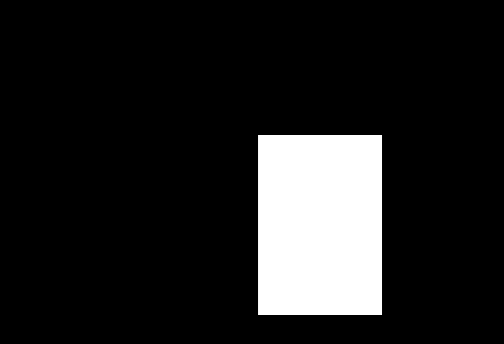

In [30]:
mask

In [31]:
image_primary = Image.open(''.join((path, '/VOC2007/JPEGImages/', image_filename, '.jpg')))
image = resize_image_div(image_primary)

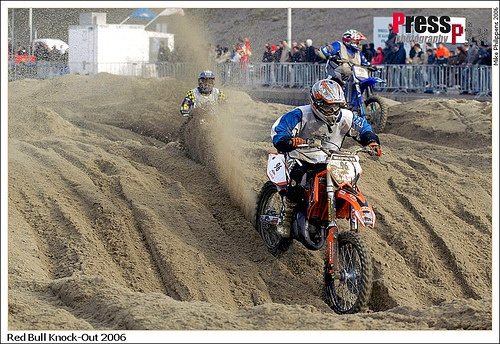

In [32]:
image_primary

## Generating prompt with LLaVA and Mistral

In [33]:
from mistral_model import MistralModel
from transformers import AutoProcessor, LlavaForConditionalGeneration
from llava_mistral_utils import generate_prompt_llava_mistral

In [34]:
device = 'cuda:0'

# LLaVA
llava = LlavaForConditionalGeneration.from_pretrained("llava-hf/llava-1.5-7b-hf").to(device)
llava_processor = AutoProcessor.from_pretrained("llava-hf/llava-1.5-7b-hf")

# Mistral 
mistral = MistralModel()

Loading checkpoint shards: 100%|██████████| 3/3 [00:12<00:00,  4.32s/it]
Special tokens have been added in the vocabulary, make sure the associated word embeddings are fine-tuned or trained.
Loading checkpoint shards: 100%|██████████| 2/2 [00:10<00:00,  5.14s/it]


In [35]:
new_object, prompt = generate_prompt_llava_mistral(pil_image=image, 
                                                     current_object=current_object,  
                                                     llava_model=llava, 
                                                     llava_processor=llava_processor, 
                                                     mistral_model=mistral, 
                                                     new_objects_list=None,
                                                     prompt_path=None,
                                                     save_prompt=False, 
                                                     device='cuda:0')

In [36]:
print(f'New object: {new_object},\n\nPrompt for new object: {prompt}')

New object: a quad bike,

Prompt for new object: a brilliant yellow quad bike with its strong frame supported by rugged tires that wrap around sturdy rims.


## PowerPaint Inference

In [8]:
from PowerPaintPipeline import StableDiffusionInpaintPipeline as Pipeline
from PowerPaintPipeline import TokenizerWrapper, add_tokens
from safetensors.torch import load_model

In [38]:
weight_dtype = torch.float16
pipe = Pipeline.from_pretrained("runwayml/stable-diffusion-inpainting", torch_dtype=weight_dtype)
pipe.tokenizer = TokenizerWrapper(
    from_pretrained="runwayml/stable-diffusion-v1-5", subfolder="tokenizer", revision=None
)

add_tokens(
    tokenizer=pipe.tokenizer,
    text_encoder=pipe.text_encoder,
    placeholder_tokens=["P_ctxt", "P_shape", "P_obj"],
    initialize_tokens=["a", "a", "a"],
    num_vectors_per_token=10,
)

load_model(pipe.unet, "./PowerPaint/models/unet/unet.safetensors")
load_model(pipe.text_encoder, "./PowerPaint/models/unet/text_encoder.safetensors", strict=False)

pipe = pipe.to(device)

text_encoder/model.safetensors not found
Loading pipeline components...:  43%|████▎     | 3/7 [00:01<00:02,  1.79it/s]An error occurred while trying to fetch /home/jovyan/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/51388a731f57604945fddd703ecb5c50e8e7b49d/unet: Error no file named diffusion_pytorch_model.safetensors found in directory /home/jovyan/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/51388a731f57604945fddd703ecb5c50e8e7b49d/unet.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
Loading pipeline components...:  57%|█████▋    | 4/7 [00:04<00:04,  1.41s/it]An error occurred while trying to fetch /home/jovyan/.cache/huggingface/hub/models--runwayml--stable-diffusion-inpainting/snapshots/51388a731f57604945fddd703ecb5c50e8e7b49d/vae: Error no file named diffusion_pytorch_model.safetensors found in directory /home/jovyan/.cache/huggingface/hub/models--runwayml--stable-diffusion

06/22 13:56:35 - mmengine - INFO - Successfully add external embeddings: P_ctxt, P_shape, P_obj.
06/22 13:56:35 - mmengine - INFO - Successfully add trainable external embeddings: P_ctxt, P_shape, P_obj


In [39]:
negative_prompt = ''
#"empty scene blur "
promptA = prompt + " P_ctxt"
promptB = prompt + " P_ctxt"

negative_promptA = negative_prompt + " P_obj"
negative_promptB = negative_prompt + " P_obj"

In [40]:
results = pipe(
        promptA=promptA,
        promptB=promptB,
        image=image,
        mask_image=mask,
        num_inference_steps=200,
        guidance_scale=5.2,
        negative_promptA=negative_promptA,
        negative_promptB=negative_promptB,
        width=image.size[0],
        height=image.size[1])

100%|██████████| 200/200 [00:06<00:00, 30.92it/s]


### Examples of work and saving new annotations

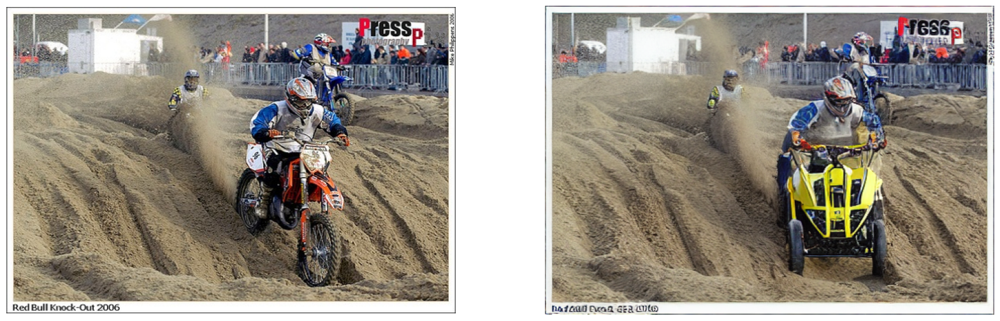

In [41]:
# guidance_scale=5.2
# num_inference_steps=200

modified_image = results.images[0].resize((image_primary.size))
image_arr = np.array(image)
modified_image_arr = np.array(modified_image)

# Plot comparison
fig, axs = plt.subplots(1, 2, figsize=(20, 10))
axs[0].imshow(image_arr)
axs[0].axis('off')
axs[1].imshow(modified_image_arr)
axs[1].axis('off')
plt.show()

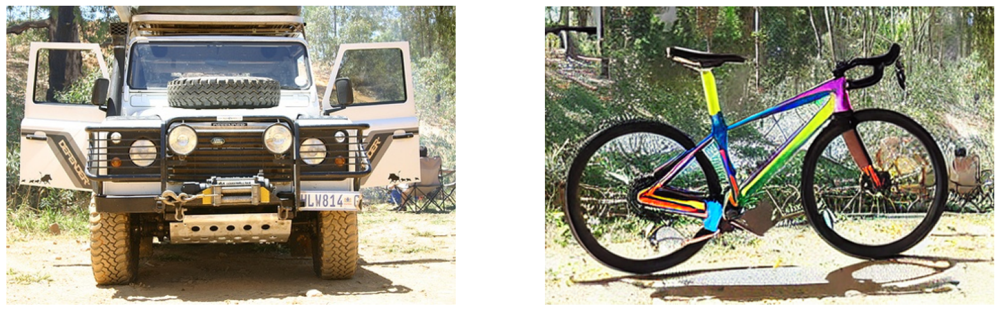

In [28]:
# guidance_scale=5.2
# num_inference_steps=200

modified_image = results.images[0].resize((image_primary.size))
image_arr = np.array(image)
modified_image_arr = np.array(modified_image)

# Plot comparison
fig, axs = plt.subplots(1, 2, figsize=(20, 10))
axs[0].imshow(image_arr)
axs[0].axis('off')
axs[1].imshow(modified_image_arr)
axs[1].axis('off')
plt.show()

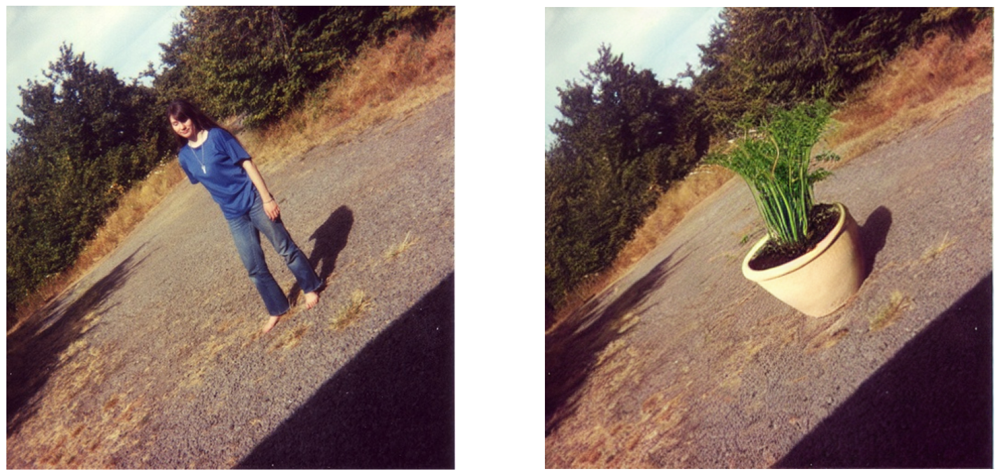

In [665]:
# guidance_scale=6
# num_inference_steps=200

modified_image = results.images[0].resize((image_primary.size))
image_arr = np.array(image)
modified_image_arr = np.array(modified_image)
modified_image.save(''.join((path, '/VOC2007_augmentation/JPEGImages/', image_filename, '.jpg')))

# Saving new annotation
modify_annotation(old_annotation_path=annotation_path, 
                  image_filename=image_filename,
                  new_object_name=new_object, 
                  selected_object_index=ind)

# Plot comparison
fig, axs = plt.subplots(1, 2, figsize=(20, 10))
axs[0].imshow(image_arr)
axs[0].axis('off')
axs[1].imshow(modified_image_arr)
axs[1].axis('off')
plt.savefig(''.join((path, '/VOC2007_augmentation/comparison/', 'comparison', image_filename, '.pdf')))
plt.show()

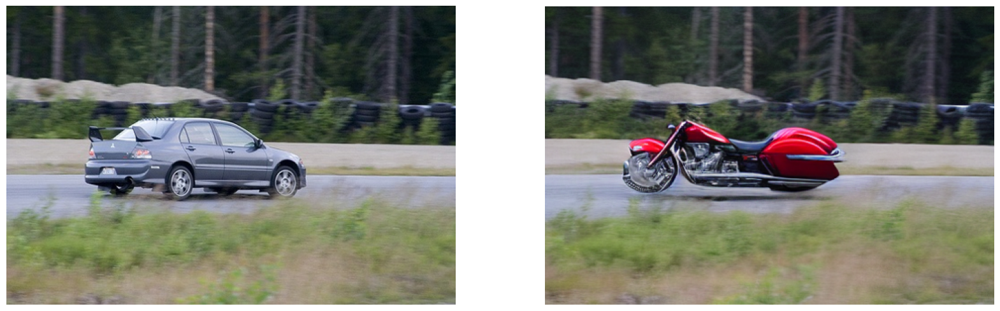

In [622]:
# guidance_scale=4
# num_inference_steps=100

modified_image = results.images[0].resize((image_primary.size))
image_arr = np.array(image)
modified_image_arr = np.array(modified_image)
modified_image.save(''.join((path, '/VOC2007_augmentation/JPEGImages/', image_filename, '.jpg')))

# Saving new annotation
modify_annotation(old_annotation_path=annotation_path, 
                  image_filename=image_filename,
                  new_object_name=new_object, 
                  selected_object_index=ind)

# Plot comparison
fig, axs = plt.subplots(1, 2, figsize=(20, 10))
axs[0].imshow(image_arr)
axs[0].axis('off')
axs[1].imshow(modified_image_arr)
axs[1].axis('off')
plt.savefig(''.join((path, '/VOC2007_augmentation/comparison/', 'comparison', image_filename, '.pdf')))
plt.show()

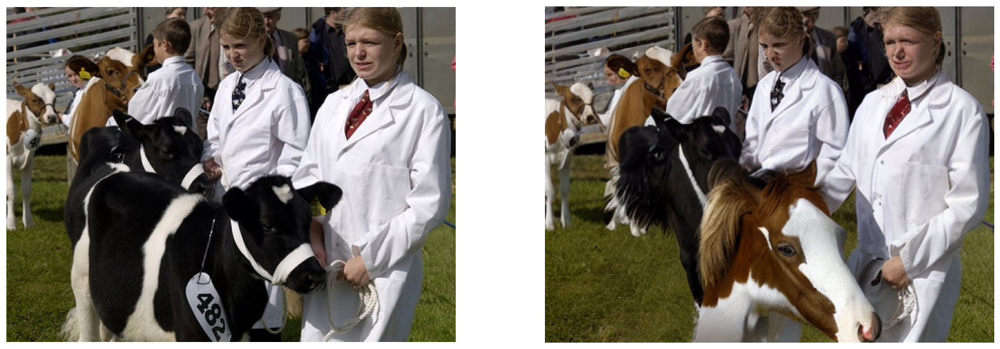

In [581]:
# guidance_scale=5
# num_inference_steps=200

modified_image = results.images[0].resize((image_primary.size))
image_arr = np.array(image)
modified_image_arr = np.array(modified_image)
modified_image.save(''.join((path, '/VOC2007_augmentation/JPEGImages/', image_filename, '.jpg')))

# Saving new annotation
modify_annotation(old_annotation_path=annotation_path, 
                  image_filename=image_filename,
                  new_object_name=new_object, 
                  selected_object_index=ind)

# Plot comparison
fig, axs = plt.subplots(1, 2, figsize=(20, 10))
axs[0].imshow(image_arr)
axs[0].axis('off')
axs[1].imshow(modified_image_arr)
axs[1].axis('off')
plt.savefig(''.join((path, '/VOC2007_augmentation/comparison/', 'comparison', image_filename, '.pdf')))
plt.show()

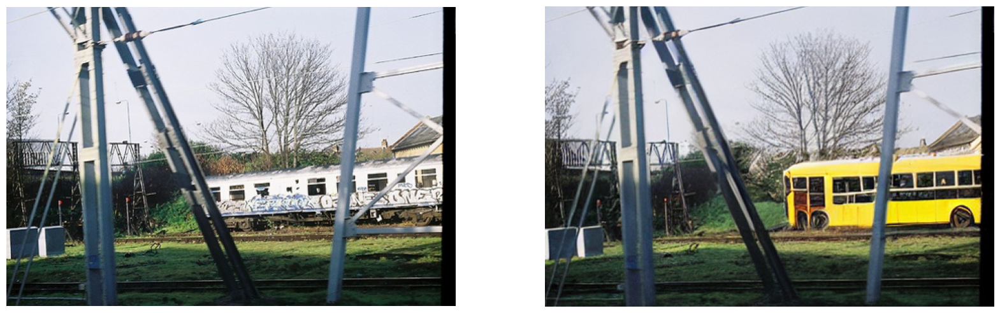

In [540]:
# guidance_scale=5
# num_inference_steps=200

modified_image = results.images[0].resize((image_primary.size))
image_arr = np.array(image)
modified_image_arr = np.array(modified_image)
modified_image.save(''.join((path, '/VOC2007_augmentation/JPEGImages/', image_filename, '.jpg')))

# Saving new annotation
modify_annotation(old_annotation_path=annotation_path, 
                  image_filename=image_filename,
                  new_object_name=new_object, 
                  selected_object_index=ind)

# Plot comparison
fig, axs = plt.subplots(1, 2, figsize=(20, 10))
axs[0].imshow(image_arr)
axs[0].axis('off')
axs[1].imshow(modified_image_arr)
axs[1].axis('off')
plt.savefig(''.join((path, '/VOC2007_augmentation/comparison/', 'comparison', image_filename, '.pdf')))
plt.show()

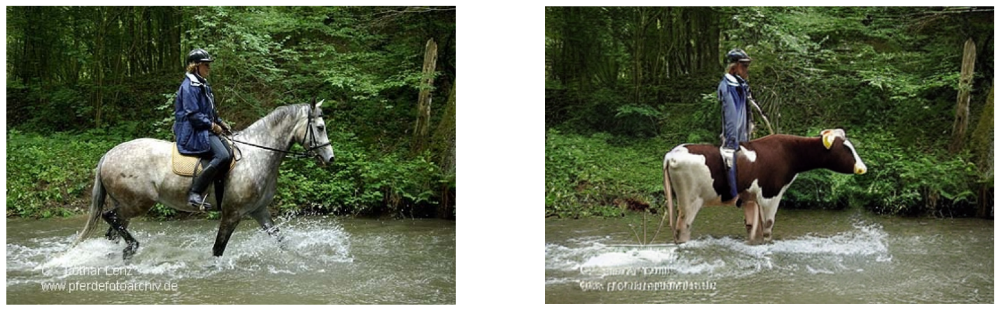

In [463]:
# guidance_scale=6
# num_inference_steps=200

modified_image = results.images[0].resize((image_primary.size))
image_arr = np.array(image)
modified_image_arr = np.array(modified_image)
modified_image.save(''.join((path, '/VOC2007_augmentation/JPEGImages/', image_filename, '.jpg')))

# Saving new annotation
modify_annotation(old_annotation_path=annotation_path, 
                  image_filename=image_filename,
                  new_object_name=new_object, 
                  selected_object_index=ind)

# Plot comparison
fig, axs = plt.subplots(1, 2, figsize=(20, 10))
axs[0].imshow(image_arr)
axs[0].axis('off')
axs[1].imshow(modified_image_arr)
axs[1].axis('off')
plt.savefig(''.join((path, '/VOC2007_augmentation/comparison/', 'comparison', image_filename, '.pdf')))
plt.show()

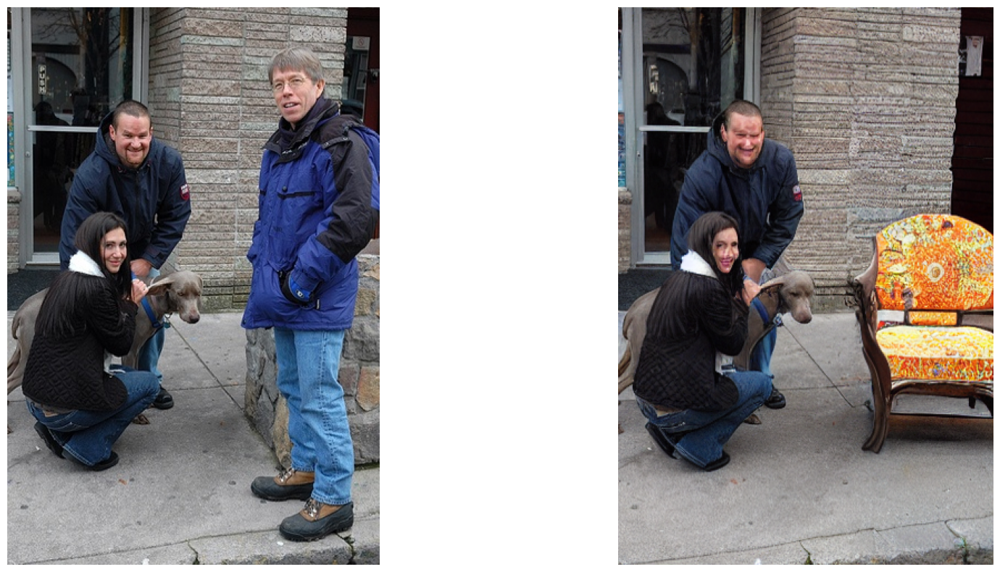

In [432]:
# guidance_scale=6
# num_inference_steps=200

modified_image = results.images[0].resize((image_primary.size))
image_arr = np.array(image)
modified_image_arr = np.array(modified_image)
modified_image.save(''.join((path, '/VOC2007_augmentation/JPEGImages/', image_filename, '.jpg')))

# Saving new annotation
modify_annotation(old_annotation_path=annotation_path, 
                  image_filename=image_filename,
                  new_object_name=new_object, 
                  selected_object_index=ind)

# Plot comparison
fig, axs = plt.subplots(1, 2, figsize=(20, 10))
axs[0].imshow(image_arr)
axs[0].axis('off')
axs[1].imshow(modified_image_arr)
axs[1].axis('off')
plt.savefig(''.join((path, '/VOC2007_augmentation/comparison/', 'comparison', image_filename, '.pdf')))
plt.show()

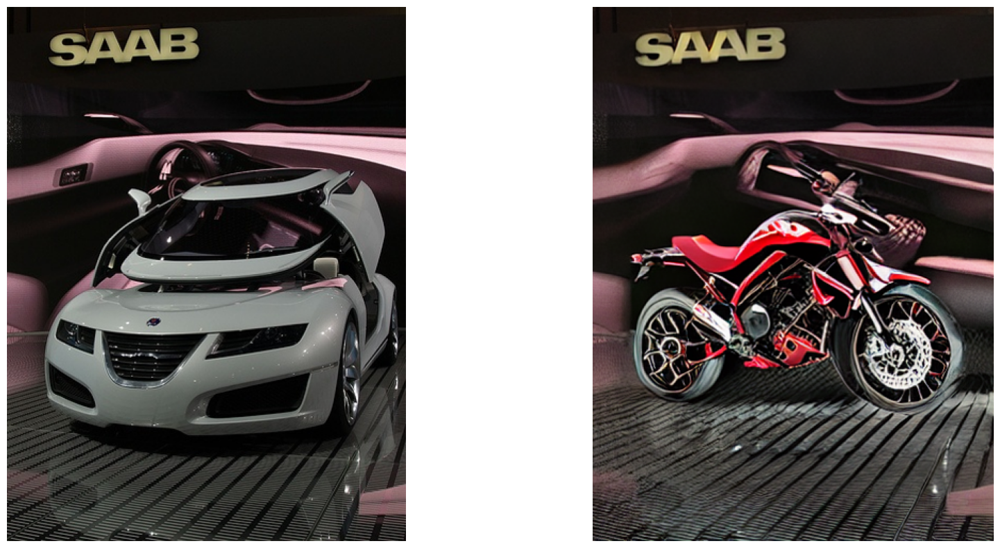

In [407]:
# guidance_scale=6
# num_inference_steps=200

modified_image = results.images[0].resize((image_primary.size))
image_arr = np.array(image)
modified_image_arr = np.array(modified_image)
modified_image.save(''.join((path, '/VOC2007_augmentation/JPEGImages/', image_filename, '.jpg')))

# Saving new annotation
modify_annotation(old_annotation_path=annotation_path, 
                  image_filename=image_filename,
                  new_object_name=new_object, 
                  selected_object_index=ind)

# Plot comparison
fig, axs = plt.subplots(1, 2, figsize=(20, 10))
axs[0].imshow(image_arr)
axs[0].axis('off')
axs[1].imshow(modified_image_arr)
axs[1].axis('off')
plt.savefig(''.join((path, '/VOC2007_augmentation/comparison/', 'comparison', image_filename, '.pdf')))
plt.show()

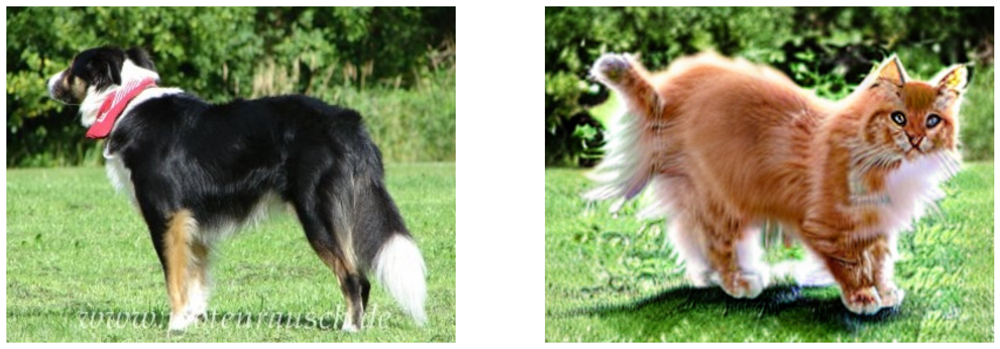

In [342]:
# guidance_scale=4.5
# num_inference_steps=100

modified_image = results.images[0].resize((image_primary.size))
image_arr = np.array(image)
modified_image_arr = np.array(modified_image)
modified_image.save(''.join((path, '/VOC2007_augmentation/JPEGImages/', image_filename, '.jpg')))

# Saving new annotation
modify_annotation(old_annotation_path=annotation_path, 
                  image_filename=image_filename,
                  new_object_name=new_object, 
                  selected_object_index=ind)

# Plot comparison
fig, axs = plt.subplots(1, 2, figsize=(20, 10))
axs[0].imshow(image_arr)
axs[0].axis('off')
axs[1].imshow(modified_image_arr)
axs[1].axis('off')
plt.savefig(''.join((path, '/VOC2007_augmentation/comparison/', 'comparison', image_filename, '.pdf')))
plt.show()

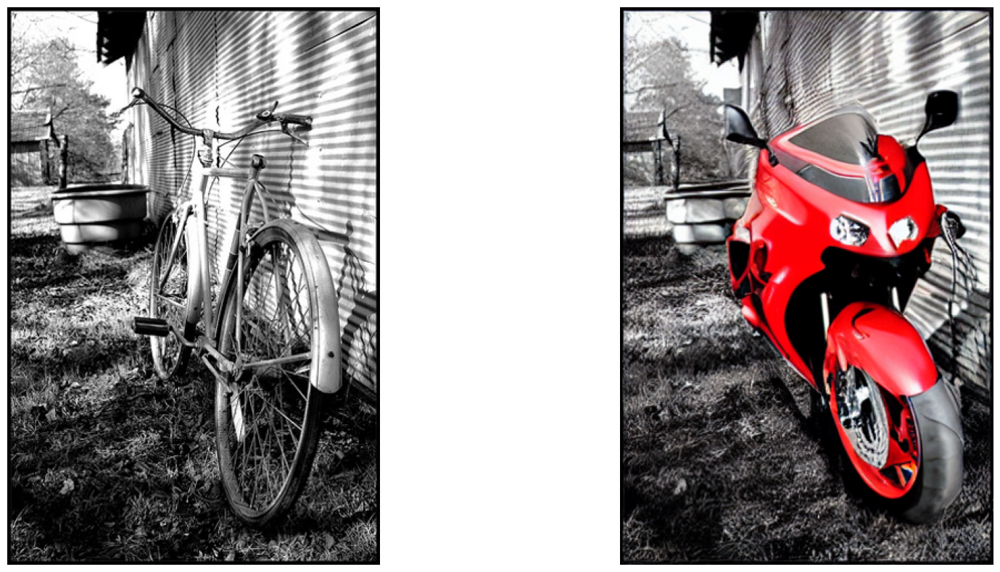

In [284]:
# guidance_scale=5
# num_inference_steps=200

modified_image = results.images[0].resize((image_primary.size))
image_arr = np.array(image)
modified_image_arr = np.array(modified_image)
modified_image.save(''.join((path, '/VOC2007_augmentation/JPEGImages/', image_filename, '.jpg')))

# Saving new annotation
modify_annotation(old_annotation_path=annotation_path, 
                  image_filename=image_filename,
                  new_object_name=new_object, 
                  selected_object_index=ind)

# Plot comparison
fig, axs = plt.subplots(1, 2, figsize=(20, 10))
axs[0].imshow(image_arr)
axs[0].axis('off')
axs[1].imshow(modified_image_arr)
axs[1].axis('off')
plt.savefig(''.join((path, '/VOC2007_augmentation/comparison/', 'comparison', image_filename, '.pdf')))
plt.show()

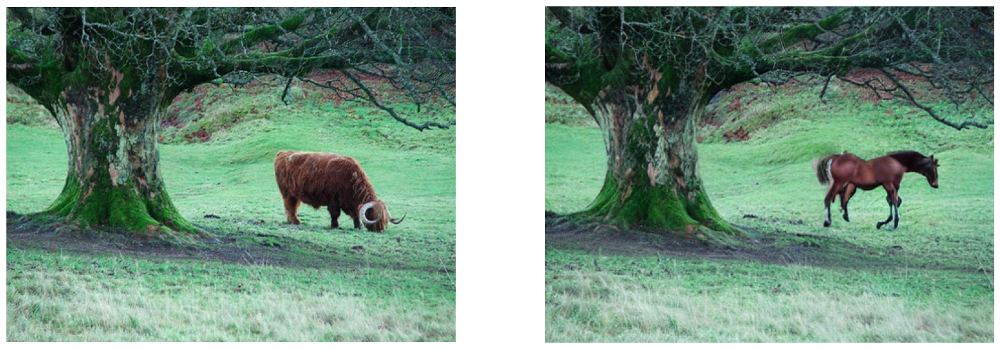

In [208]:
# guidance_scale=4.5
# num_inference_steps=200

modified_image = results.images[0].resize((image_primary.size))
image_arr = np.array(image)
modified_image_arr = np.array(modified_image)
modified_image.save(''.join((path, '/VOC2007_augmentation/JPEGImages/', image_filename, '.jpg')))

# Saving new annotation
modify_annotation(old_annotation_path=annotation_path, 
                  image_filename=image_filename,
                  new_object_name=new_object, 
                  selected_object_index=ind)

# Plot comparison
fig, axs = plt.subplots(1, 2, figsize=(20, 10))
axs[0].imshow(image_arr)
axs[0].axis('off')
axs[1].imshow(modified_image_arr)
axs[1].axis('off')
plt.savefig(''.join((path, '/VOC2007_augmentation/comparison/', 'comparison', image_filename, '.pdf')))
plt.show()

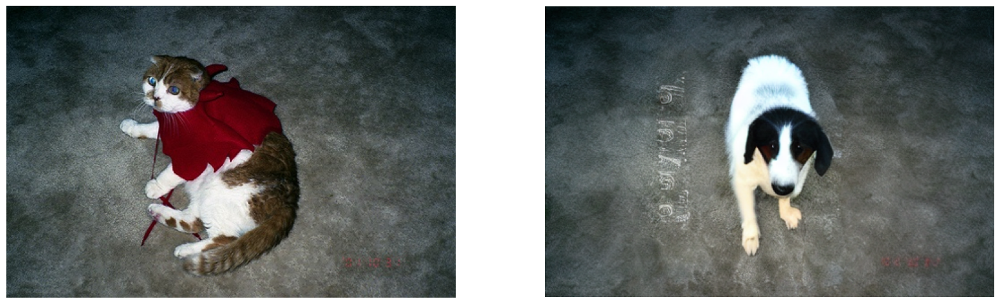

In [126]:
# guidance_scale=6.5
# num_inference_steps=200

modified_image = results.images[0].resize((image_primary.size))
image_arr = np.array(image)
modified_image_arr = np.array(modified_image)
modified_image.save(''.join((path, '/VOC2007_augmentation/JPEGImages/', image_filename, '.jpg')))

# Saving new annotation
modify_annotation(old_annotation_path=annotation_path, 
                  image_filename=image_filename,
                  new_object_name=new_object, 
                  selected_object_index=ind)

# Plot comparison
fig, axs = plt.subplots(1, 2, figsize=(20, 10))
axs[0].imshow(image_arr)
axs[0].axis('off')
axs[1].imshow(modified_image_arr)
axs[1].axis('off')
plt.savefig(''.join((path, '/VOC2007_augmentation/comparison/', 'comparison', image_filename, '.pdf')))
plt.show()

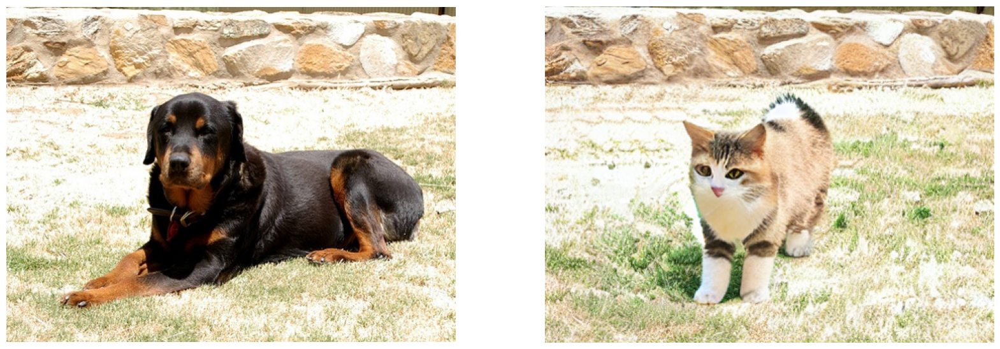

In [38]:
# guidance_scale=4
# num_inference_steps=200

modified_image = results.images[0].resize((image_primary.size))
image_arr = np.array(image)
modified_image_arr = np.array(modified_image)

# Saving new annotation
#modify_annotation(old_annotation_path=annotation_path, 
                  #image_filename=image_filename,
                  #new_object_name=new_object, 
                  #selected_object_index=ind)

# Plot comparison
fig, axs = plt.subplots(1, 2, figsize=(20, 10))
axs[0].imshow(image_arr)
axs[0].axis('off')
axs[1].imshow(modified_image_arr)
axs[1].axis('off')
plt.show()

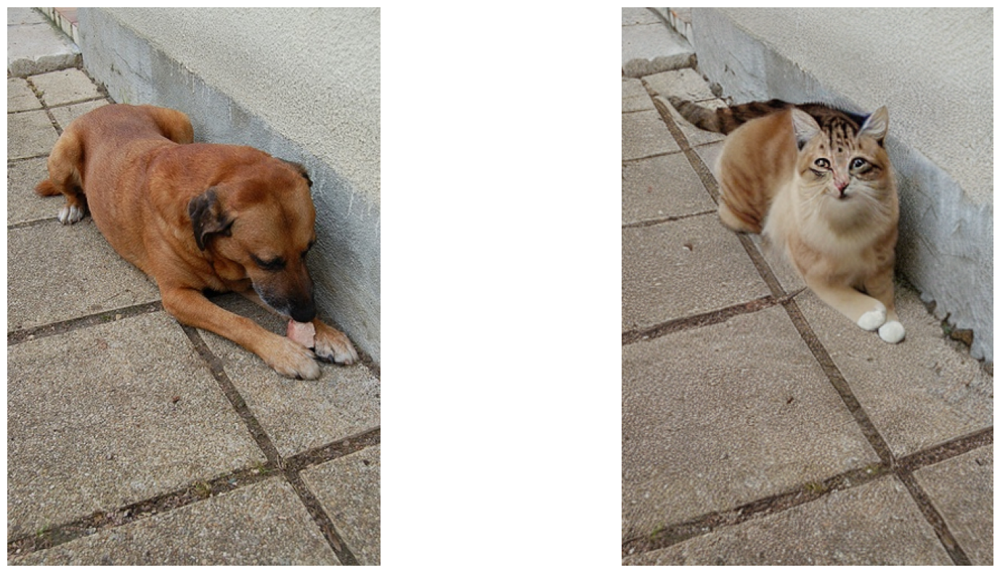

In [59]:
# guidance_scale=4.5
# num_inference_steps=200

modified_image = results.images[0].resize((image_primary.size))
image_arr = np.array(image)
modified_image_arr = np.array(modified_image)

# Saving new annotation
modify_annotation(old_annotation_path=annotation_path, 
                  image_filename=image_filename,
                  new_object_name=new_object, 
                  selected_object_index=ind)

# Plot comparison
fig, axs = plt.subplots(1, 2, figsize=(20, 10))
axs[0].imshow(image_arr)
axs[0].axis('off')
axs[1].imshow(modified_image_arr)
axs[1].axis('off')
plt.show()

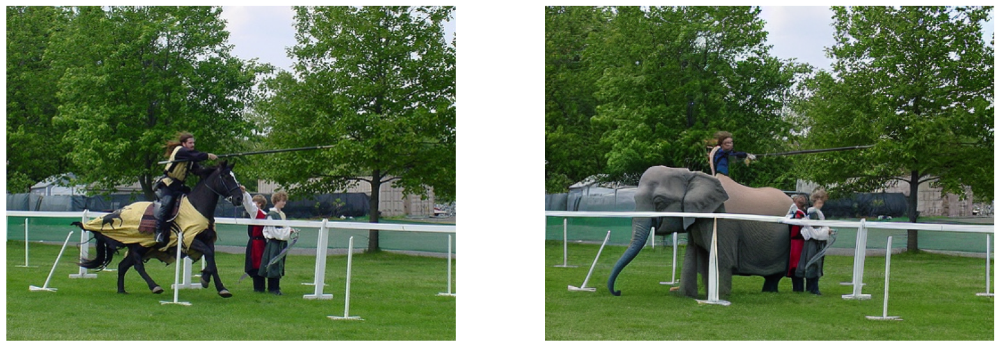

In [290]:
# guidance_scale=6
# num_inference_steps=200

modified_image = results.images[0].resize((image_primary.size))
image_arr = np.array(image)
modified_image_arr = np.array(modified_image)

# Saving new annotation
modify_annotation(old_annotation_path=annotation_path, 
                  image_filename=image_filename,
                  new_object_name=new_object, 
                  selected_object_index=ind)

# Plot comparison
fig, axs = plt.subplots(1, 2, figsize=(20, 10))
axs[0].imshow(image_arr)
axs[0].axis('off')
axs[1].imshow(modified_image_arr)
axs[1].axis('off')
plt.show()

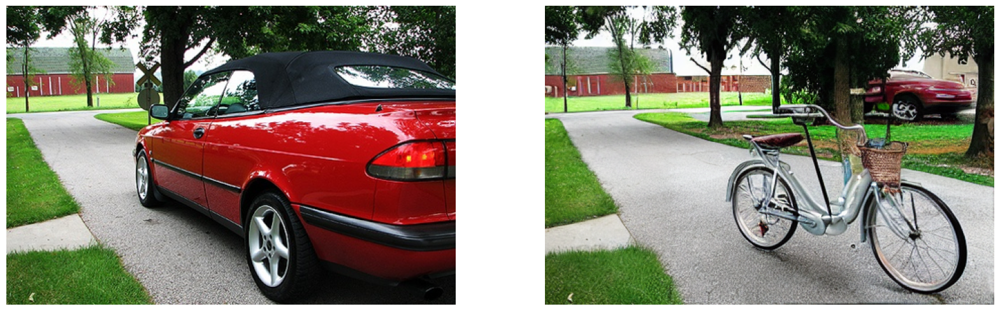

In [258]:
# guidance_scale=6
# num_inference_steps=100

modified_image = results.images[0].resize((image_primary.size))
image_arr = np.array(image)
modified_image_arr = np.array(modified_image)

# Saving new annotation
modify_annotation(old_annotation_path=annotation_path, 
                  image_filename=image_filename,
                  new_object_name=new_object, 
                  selected_object_index=ind)

# Plot comparison
fig, axs = plt.subplots(1, 2, figsize=(20, 10))
axs[0].imshow(image_arr)
axs[0].axis('off')
axs[1].imshow(modified_image_arr)
axs[1].axis('off')
plt.show()